In [623]:
%matplotlib inline
import h5pyd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.spatial import cKDTree

In [624]:
f = h5pyd.File("/nrel/nsrdb/v3/nsrdb_2012.h5", 'r')

In [ ]:
f

<HDF5 file "nsrdb_2012.h5" (mode r)>

<HDF5 file "nsrdb_2012.h5" (mode r)>

In [ ]:
list(f) 

['air_temperature',
 'alpha',
 'aod',
 'asymmetry',
 'cld_opd_dcomp',
 'cld_reff_dcomp',
 'clearsky_dhi',
 'clearsky_dni',
 'clearsky_ghi',
 'cloud_press_acha',
 'cloud_type',
 'coordinates',
 'dew_point',
 'dhi',
 'dni',
 'fill_flag',
 'ghi',
 'meta',
 'ozone',
 'relative_humidity',
 'solar_zenith_angle',
 'ssa',
 'surface_albedo',
 'surface_pressure',
 'time_index',
 'total_precipitable_water',
 'wind_direction',
 'wind_speed']

In [ ]:
type(f)

h5pyd._hl.files.File

In [ ]:
with h5pyd.File('/nrel/nsrdb/v3/nsrdb_2011.h5', mode='r') as f:
    # Extract time_index and convert to datetime
    # NOTE: time_index is saved as byte-strings and must be decoded
    time_index = pd.to_datetime(f['time_index'][...].astype(str))
    # Initialize DataFrame to store time-series data
    time_series = pd.DataFrame(index=time_index)
    # Extract variables needed to compute generation from SAM:
    for var in ['day_of_year','year','air_temperature','alpha', 'aod','asymmetry','cld_opd_dcomp','cld_reff_dcomp', 'clearsky_dhi','clearsky_dni', 'clearsky_ghi','cloud_press_acha',
 'cloud_type','dew_point','dhi','dni', 'ghi','ozone','relative_humidity','solar_zenith_angle','ssa','surface_albedo','surface_pressure','total_precipitable_water','wind_direction','wind_speed']:
            print(var)
            if var == 'day_of_year':
                time_series[var] = time_series.index.dayofyear
            elif var == 'year':
                time_series[var] = time_series.index.year
            else:
                # Get dataset
                ds = f[var]
                # Extract scale factor
                scale_factor = ds.attrs['psm_scale_factor']
                # Extract site 100 and add to DataFrame
                time_series[var] = ds[:, 100] / scale_factor

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


In [ ]:
time_series.dni[0:48].mean()


19.208333333333332

In [ ]:
time_series.shape[0]/48

365.0

In [ ]:
time_series = time_series.loc[time_series.index >= '2011-05-14 00:00:00']
time_series['day_of_year'] = time_series.index.dayofyear

In [ ]:
hourly_data = pd.DataFrame()

In [ ]:
# print(f'what is wanted: {time_series[:48].shape}')

for i in range(0,time_series.shape[0],48):
    #print(time_series[i:i+48].mean(axis=0))
    hourly_data = hourly_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)

C:\Users\HP\AppData\Local\Temp\ipykernel_17712\13606620.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  daily_data = daily_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\13606620.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  daily_data = daily_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\13606620.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  daily_data = daily_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\13606620.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future v

In [ ]:
daily_data.iloc[0]

day_of_year                 134.000000
dni                         292.458333
dhi                          42.854167
relative_humidity            86.515625
wind_direction              136.150000
wind_speed                    4.489583
dew_point                    21.875000
air_temperature              25.145833
clearsky_dhi                 32.291667
clearsky_dni                323.041667
cloud_type                    2.750000
total_precipitable_water      3.888833
Name: 0, dtype: float64

In [ ]:
# daily_data = pd.DataFrame()
# print(f'what is wanted: {time_series[:48].shape}')
for year in range(12,21):
    with h5pyd.File(f'/nrel/nsrdb/v3/nsrdb_20{year}.h5', mode='r') as f:
        # Extract time_index and convert to datetime
        # NOTE: time_index is saved as byte-strings and must be decoded
        time_index = pd.to_datetime(f['time_index'][...].astype(str))
        # Initialize DataFrame to store time-series data
        time_series = pd.DataFrame(index=time_index)
        # Extract variables needed to compute generation from SAM:
        for var in ['day_of_year','dni','dhi','relative_humidity','wind_direction', 'wind_speed','dew_point','air_temperature','clearsky_dhi', 'clearsky_dni','cloud_type','total_precipitable_water']:
            
            if var == 'day_of_year':
                time_series[var] = time_series.index.dayofyear
            else:
                # Get dataset
                ds = f[var]
                # Extract scale factor
                scale_factor = ds.attrs['psm_scale_factor']
                # Extract site 100 and add to DataFrame
                time_series[var] = ds[:, 100] /scale_factor


    for i in range(0,time_series.shape[0],48):
        #print(time_series[i:i+48].mean(axis=0))
        daily_data = daily_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)

C:\Users\HP\AppData\Local\Temp\ipykernel_17712\2481898116.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  daily_data = daily_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\2481898116.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  daily_data = daily_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\2481898116.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  daily_data = daily_data.append(time_series[i:i+48].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\2481898116.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas i

In [ ]:
daily_data.iloc[1]

day_of_year                 135.000000
dni                          50.479167
dhi                          62.854167
relative_humidity            86.591042
wind_direction              129.137500
wind_speed                    5.845833
dew_point                    21.812500
air_temperature              24.895833
clearsky_dhi                 33.562500
clearsky_dni                314.375000
cloud_type                    2.500000
total_precipitable_water      4.145042
Name: 1, dtype: float64

In [ ]:
daily_data.to_excel('nsrdb_2011May14_2020_10years_daily.xlsx')

In [ ]:
daily_data[134:].shape

(3386, 12)

In [ ]:
bus_data = pd.read_excel('Bus Barn and Car Charging Solar Data.xlsx')

In [ ]:

flow = bus_data.iloc[:,1].drop(0,axis=0)

In [ ]:
flow = flow.reset_index().drop('index',axis=1)

In [ ]:
flow['Unnamed: 1']

0                 0
1                 0
2                 0
3                 0
4                 0
            ...    
108321     5.203238
108322     7.773371
108323    11.066359
108324     4.890486
108325     8.376925
Name: Unnamed: 1, Length: 108326, dtype: object

In [ ]:
def clear_func(x):
    try:
        if x > 40:
            return 0 
        else: 
            return x
    except:
        return 0 
    

In [ ]:
flow = flow["Unnamed: 1"].apply(clear_func)

In [ ]:
flow[0:24].mean(axis=0)

0.548614423271426

In [ ]:
bus_data = pd.DataFrame(columns=['mean','sum'])

In [ ]:
bus_data

,mean,sum


In [ ]:
flow[0:0+24].mean(axis=0).item(), flow[0:0+24].sum(axis=0).item()

(0.548614423271426, 13.166746158514222)

In [ ]:
for i in range(0,flow.shape[0],24):
    #print(time_series[i:i+48].mean(axis=0))
    try:
        bus_data = bus_data.append({'mean':flow[i:i+24].mean(axis=0).item(),'sum':flow[i:i+24].sum(axis=0).item()},ignore_index=True)
    except:
        print({'mean':flow[i:i+24].mean(axis=0),'sum':flow[i:i+24].sum(axis=0)})

C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4228109002.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bus_data = bus_data.append({'mean':flow[i:i+24].mean(axis=0).item(),'sum':flow[i:i+24].sum(axis=0).item()},ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4228109002.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bus_data = bus_data.append({'mean':flow[i:i+24].mean(axis=0).item(),'sum':flow[i:i+24].sum(axis=0).item()},ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4228109002.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bus_data = bus_data.append({'mean':flow[i:i+24].mean(axis=0).item(),'sum':flow[i:i+24].sum(axis=0).item()},ignore_index=True)
C:\Users\HP\AppData\Local

C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4228109002.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bus_data = bus_data.append({'mean':flow[i:i+24].mean(axis=0).item(),'sum':flow[i:i+24].sum(axis=0).item()},ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4228109002.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bus_data = bus_data.append({'mean':flow[i:i+24].mean(axis=0).item(),'sum':flow[i:i+24].sum(axis=0).item()},ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4228109002.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bus_data = bus_data.append({'mean':flow[i:i+24].mean(axis=0).item(),'sum':flow[i:i+24].sum(axis=0).item()},ignore_index=True)
C:\Users\HP\AppData\Local

In [ ]:
bus_data[:6]

,mean,sum
0,0.548614,13.166746
1,4.917101,118.010418
2,7.255619,174.134858
3,7.285780,174.858719
4,6.880336,165.128067
5,6.177652,148.263639


In [ ]:
import matplotlib.pyplot as plt

In [ ]:
bus_data['sum'].tolist(), bus_data.shape[0]

([13.166746158514222,
  118.01041782995415,
  174.13485834584128,
  174.85871866259941,
  165.1280674611292,
  148.26363925894933,
  111.55013100848555,
  159.99717987445388,
  95.52308249561355,
  194.70886883985247,
  165.54838037226233,
  51.919788867507094,
  193.71362269995217,
  150.28186378013984,
  81.00711790325781,
  60.43673964219114,
  211.06157945695273,
  167.15084296544356,
  208.83073251247313,
  41.957178541294184,
  207.55710777084346,
  130.22340744302502,
  182.475621462167,
  207.62988558513726,
  210.62716333325943,
  167.01898352728324,
  43.842523362273795,
  94.05386128418905,
  90.25685816437633,
  160.43154955459988,
  138.06423771944412,
  128.07375751466788,
  110.84044923690914,
  211.4103416906164,
  119.28963143209384,
  76.11311104587878,
  153.77157691626746,
  151.2120067792551,
  172.36139788909495,
  56.836388975343084,
  84.30571949021093,
  189.28442792024993,
  44.27971869071153,
  192.98142584104275,
  171.6184845935814,
  228.52652071339804,
  

In [ ]:
bus_data.iloc[2110]

mean      6.033087
sum     144.794082
Name: 2110, dtype: float64

In [ ]:
bus_data['mean'].argmax()


2236

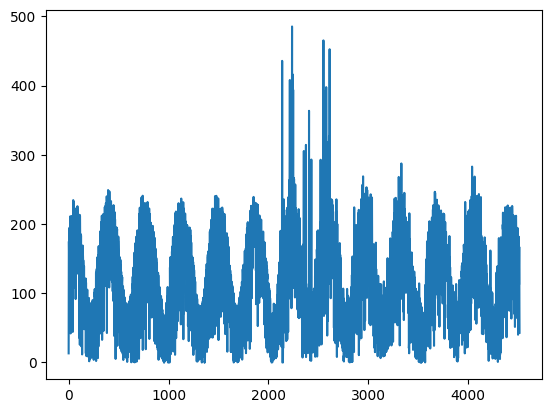

In [ ]:
plt.plot(bus_data['sum'].tolist())

In [ ]:
full_data = pd.concat([bus_data,daily_data],axis=1)

In [ ]:
full_data = full_data.dropna(axis=0)

In [ ]:
print(full_data)

          mean         sum  day_of_year         dni         dhi  \
0     0.548614   13.166746        134.0  292.458333   42.854167   
1     4.917101  118.010418        135.0   50.479167   62.854167   
2     7.255619  174.134858        136.0  242.895833   46.145833   
3     7.285780  174.858719        137.0  228.729167   60.729167   
4     6.880336  165.128067        138.0  175.020833   79.062500   
...        ...         ...          ...         ...         ...   
3515  1.022005   24.528118        362.0  396.312500   51.479167   
3516  1.813210   43.517045        363.0  378.895833   80.770833   
3517  0.857416   20.577987        364.0  144.000000  108.375000   
3518  2.427310   58.255443        365.0  120.000000  154.416667   
3519  0.582515   13.980354        366.0  282.083333  104.541667   

      relative_humidity  wind_direction  wind_speed  dew_point  \
0             86.515625      136.150000    4.489583  21.875000   
1             86.591042      129.137500    5.845833  21.812500 

In [ ]:
targets = ['sum']
features = ['day_of_year', 'dni', 'dhi', 'relative_humidity', 'wind_direction', 'wind_speed', 'dew_point', 'air_temperature', 'clearsky_dhi', 'clearsky_dni', 'cloud_type', 'total_precipitable_water']

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn

In [ ]:
full_data[features].to_numpy(),full_data[targets].to_numpy()

(array([[134.        , 292.45833333,  42.85416667, ..., 323.04166667,
           2.75      ,   3.88883333],
        [135.        ,  50.47916667,  62.85416667, ..., 314.375     ,
           2.5       ,   4.14504167],
        [136.        , 242.89583333,  46.14583333, ..., 328.04166667,
           0.83333333,   2.96270833],
        ...,
        [364.        , 144.        , 108.375     , ..., 429.3125    ,
           4.04166667,   5.15625   ],
        [365.        , 120.        , 154.41666667, ..., 408.35416667,
           5.58333333,   5.25416667],
        [366.        , 282.08333333, 104.54166667, ..., 414.72916667,
           3.625     ,   4.96875   ]]),
 array([[ 13.16674616],
        [118.01041783],
        [174.13485835],
        ...,
        [ 20.57798661],
        [ 58.25544295],
        [ 13.98035421]]))

In [ ]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(full_data[features].to_numpy(), full_data[targets].to_numpy().reshape(-1,), test_size=0.2, random_state=42)

# Standardize the features
# scaler = StandardScaler()
# X_train = scaler.fit_transform(X_train)
# X_test = scaler.transform(X_test)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Convert to PyTorch tensors
X_train = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train = torch.tensor(y_train, dtype=torch.float32).to(device)
X_test = torch.tensor(X_test, dtype=torch.float32).to(device)
y_test = torch.tensor(y_test, dtype=torch.float32).to(device)

In [ ]:
class TransformerModel(nn.Module):
    def __init__(self, input_dim, output_dim, num_heads, hidden_dim, num_layers):
        super(TransformerModel, self).__init__()
        
        self.transformer = nn.TransformerEncoder(
            nn.TransformerEncoderLayer(
                d_model=input_dim,
                nhead=num_heads,
                dim_feedforward=hidden_dim
            ),
            num_layers=num_layers
        )
        
        self.fc = nn.Linear(input_dim, output_dim)
    
    def forward(self, x):
        x = self.transformer(x)
        x = self.fc(x[:, -1, :])  # Take the output of the last time step
        return x


In [ ]:
def prepare_batches(X, y, batch_size):
    num_samples = len(X)
    num_batches = num_samples // batch_size
    X_batched = np.array_split(X, num_batches)
    y_batched = np.array_split(y, num_batches)
    return zip(X_batched, y_batched)

In [ ]:
batched_train_data = prepare_batches(X_train, y_train, batch_size=32)

In [ ]:
input_dim = X_train.shape[1]
output_dim = 1
num_heads = 2
hidden_dim = 128
num_layers = 2

# Initialize the model
model = TransformerModel(input_dim, output_dim, num_heads, hidden_dim, num_layers)

In [ ]:
model = model.to(device)

In [ ]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [ ]:
X_train.shape

torch.Size([2816, 12])

In [ ]:
y_train

tensor([134.5681,  93.2557, 143.5875,  ..., 109.8705,  14.6920,  45.1910],
       device='cuda:0')

In [ ]:
batch_size = 4

In [ ]:
train_dataset = torch.utils.data.TensorDataset(X_train, y_train)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)


In [ ]:
num_epochs = 100

for epoch in range(num_epochs):
    model.train()
    total_loss = 0.0
    for X_batch, y_batch in train_loader:
        #print(X_batch.view(batch_size,1,-1).shape)
        outputs = model((X_batch.view(batch_size,1,-1)))
        loss = criterion(outputs.squeeze(), y_batch)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
    
    # Calculate average loss for the epoch
    average_loss = total_loss / len(train_loader)
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {average_loss:.4f}')
    with torch.no_grad():
        test_outputs = model(X_test.view(X_test.shape[0],1,-1))
        test_loss = criterion(test_outputs, y_test)
        print(f'Test Loss: {test_loss.item():.4f}')

Epoch [1/100], Loss: 16396.0679
Test Loss: 11837.5674


e:\Anaconda\envs\py39\lib\site-packages\torch\nn\modules\loss.py:529: UserWarning: Using a target size (torch.Size([704])) that is different to the input size (torch.Size([704, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [2/100], Loss: 9335.8364
Test Loss: 5938.0342
Epoch [3/100], Loss: 5709.9416
Test Loss: 4715.0278
Epoch [4/100], Loss: 5129.7255
Test Loss: 4773.3428
Epoch [5/100], Loss: 3961.7753
Test Loss: 5577.2217
Epoch [6/100], Loss: 3356.4843
Test Loss: 5957.2300
Epoch [7/100], Loss: 3221.5162
Test Loss: 6359.0415
Epoch [8/100], Loss: 3132.0470
Test Loss: 6566.4697
Epoch [9/100], Loss: 3138.4159
Test Loss: 6672.4131
Epoch [10/100], Loss: 3026.2142
Test Loss: 6694.2007
Epoch [11/100], Loss: 2943.4713
Test Loss: 6505.6011
Epoch [12/100], Loss: 3022.8760
Test Loss: 6376.3096
Epoch [13/100], Loss: 3014.9185
Test Loss: 6767.3838
Epoch [14/100], Loss: 3016.8263
Test Loss: 6458.0962
Epoch [15/100], Loss: 2999.3969
Test Loss: 6492.6279
Epoch [16/100], Loss: 2955.4710
Test Loss: 7179.5396
Epoch [17/100], Loss: 2938.6692
Test Loss: 6577.4648
Epoch [18/100], Loss: 2992.2193
Test Loss: 6969.5659
Epoch [19/100], Loss: 2926.4381
Test Loss: 6947.5312
Epoch [20/100], Loss: 2910.0986
Test Loss: 6809.0962
E

In [ ]:
torch.save(model,'200_epoch')

In [ ]:
model.eval()
with torch.no_grad():
    test_outputs = model(X_test.view(X_test.shape[0],1,-1))
    test_loss = criterion(test_outputs, y_test)
    print(f'Test Loss: {test_loss.item():.4f}')

Test Loss: 7591.3208


e:\Anaconda\envs\py39\lib\site-packages\torch\nn\modules\loss.py:529: UserWarning: Using a target size (torch.Size([704])) that is different to the input size (torch.Size([704, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


In [ ]:
full_data .to_excel('full.xlsx')

In [ ]:
import gym
from gym import spaces

In [ ]:
y_train.max()

tensor(485.2926, device='cuda:0')

In [627]:
class BusArrayEnv(gym.Env):
   
    metadata = {'render.modes': ['human']}

    def __init__(self, 
                 df,
                 df_true,
                step_index = 0,
                episode_no = 0,
                save_logs = True,
                env_type = "train"):
        
        self.type = env_type
        self.df = df
        self.df_true = df_true
        self.save_logs = save_logs
        #self.action_space = spaces.Discrete(2,)
        self.action_space = spaces.Box(low = 0, high = (self.df_true.max().item() + 100),shape = (1,)) 
        # [remaining cash] + [stock price] + [technical features] + [number of stocks]
        self.observation_space = spaces.Box(low=-np.inf, 
                                            high=np.inf, 
                                            shape = (df.shape[1],))

        # load data from a pandas dataframe
        # self.data = self.df.loc[[self.step_index]]
        # [0] for drawdown till now + [0] is for % of cash/initial_amount + [0] for % return since last purchase from 0 stocks + [0] for action + 7 x [0] for pct change in asset memories
        self.step_index = step_index
        self.state = self.df[step_index,:]
        self.truth = self.df_true[step_index].item()
        self.terminal = False           

        self.reward = 0.0   
        
        self.episode_count = episode_no
        
        self.reward_memory = []
        self.date_memory=[]
        self.action_memory = []
        self.truth_memory = []

    def _append_memories(self, action):
        # store memories
        self.action_memory.append(action)    
        self.date_memory.append(int(self.state[0]))
        self.truth_memory.append(self.truth)   
        self.reward_memory.append(self.reward)
        #self.action_required_asset.append(required_stock_amount
    

    def _terminal_step(self, action=None):
        self.reward = -((action - self.truth)**2 )
        self._append_memories(action)
        #self.step_index += 1
        #self.state = self.df[self.step_index,:]
        #self.truth = self.df_true[self.step_index]
        logs_df = pd.DataFrame()

        logs_df['date'] = self.date_memory
        logs_df['action'] = self.action_memory
        logs_df['truth'] = self.truth_memory
        logs_df['reward'] = self.reward_memory      
        #import pdb; pdb.set_trace()
        #logs_df.drop('return_pct_change',axis=1)
        logs_df.to_csv(f"results/logs/log_episode_{self.episode_count}.csv",index=False)
        
        
        if self.save_logs:
            with open(f"results/logs/consol_log_{self.episode_count}.txt","w+") as f:
                f.write(f"Episode: {self.episode_count}\nSteps Taken: {self.step_index+1}\nterminal_reward: {self.reward}\nmean_reward: {sum(self.reward_memory)/len(self.reward_memory)}\n")

        #self._apply_reward_threshold_alpha(alpha=self.reward_threshold_alpha)
        #self.reward = self.cumulative_reward
        self.episode_count += 1
        
        
    def step(self, action):
        action = round(float(action),4)
        self.terminal = self.step_index >= self.df.shape[0] -1
        
            
        if self.terminal:
           self._terminal_step(action=action)
            
        else:
            
            self.reward = -((action - self.truth)**2)
            self._append_memories(action)
            self.step_index += 1
            self.state = self.df[self.step_index,:]
            self.truth = self.df_true[self.step_index].item()
            
            #self.date_memory.append(int(self.state[0]))      

        return self.state, self.reward, self.terminal, {}
        

    def reset(self):
        self.step_index = 0
        self.state = self.df[self.step_index,:]
        self.truth = self.df_true[self.step_index].item()
        self.terminal = False           

        self.reward = 0.0   
        self.reward_memory = []
        self.date_memory=[]
        self.action_memory = []
        self.truth_memory = []


        return self.state
    
    def render(self, mode='human'):
        return self.state, self.cash, self.stocks_owned, self.close_price
    
    def sigmoid_sign(ary, thresh):
        def sigmoid(x):
            return 1 / (1 + np.exp(-x * np.e)) - 0.5

        return sigmoid(ary / thresh) * thresh

In [ ]:
X_train[0,:]

tensor([ 80.0000,  40.4583, 104.4792,  95.2319, 123.6250,   6.3187,  24.3750,
         26.1250,  41.9167, 358.8750,   5.2083,   6.0971], device='cuda:0')

In [ ]:
from stable_baselines3.common.evaluation import evaluate_policy
import time
from stable_baselines3.common.vec_env import DummyVecEnv

In [ ]:
X_train.cpu()[1,:][0].item()

239.0

In [ ]:
env_train = DummyVecEnv([lambda: BusArrayEnv(df=X_train.cpu(), df_true = y_train.cpu())])

In [ ]:
"""""TD3 model"""

from stable_baselines3 import TD3
from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise
def train_TD3(env_train, model_name, data_length, device, episodes=2, exploration=0):

    # add the noise objects for DDPG

    batch_size=100
    buffer_size=100000
    # episodic=False
    gamma= 0.9
    lr= 0.000111834574100761
    noise_std= 0.930948896639477
    noise_type= 'normal'
    #train_freq= 16
    tau=0.001
    target_noise_clip=0.01
    policy_delay=5

    
    policy_kwargs = dict(net_arch=[300, 500, 300])

    n_actions = env_train.action_space.shape[-1]
    #param_noise = None
    
    if noise_type=='normal':
        action_noise=NormalActionNoise(mean=np.zeros(n_actions), sigma=noise_std * np.ones(n_actions))
    else:
        action_noise = OrnsteinUhlenbeckActionNoise(mean=np.zeros(n_actions), sigma=noise_std * np.ones(n_actions))
        

    start = time.time()
    #env_train.reset()
    TD3_model = TD3('MlpPolicy', env_train, verbose=0, 
            
            batch_size=batch_size,
            buffer_size=int(buffer_size),
            gamma=gamma,
            learning_rate=lr,
            #train_freq=train_freq,
            action_noise=action_noise,
            policy_kwargs=policy_kwargs,
            target_noise_clip=target_noise_clip,
            #optimize_memory_usage=False,
            policy_delay=policy_delay,
            tau=tau,
            learning_starts=exploration * data_length,
            device=device)
    TD3_model.learn(total_timesteps=episodes*data_length)
 
    end = time.time()

    TD3_model.save(f"results/{model_name}")
    print('Training time (TD3): ', (end-start)/60,' minutes')
    return model

TD3_model = train_TD3(env_train, "xxx", data_length=X_train.shape[0] - 1, device='cuda', episodes=63, exploration=3)


KeyboardInterrupt: 

In [ ]:
with h5pyd.File('/nrel/nsrdb/v3/nsrdb_2011.h5', mode='r') as f:
    # Extract time_index and convert to datetime
    # NOTE: time_index is saved as byte-strings and must be decoded
    time_index = pd.to_datetime(f['time_index'][...].astype(str))
    # Initialize DataFrame to store time-series data
    time_series = pd.DataFrame(index=time_index)
    # Extract variables needed to compute generation from SAM:
    for var in ['day_of_year','year','air_temperature','alpha', 'aod','asymmetry','cld_opd_dcomp','cld_reff_dcomp', 'clearsky_dhi','clearsky_dni', 'clearsky_ghi','cloud_press_acha',
 'cloud_type','dew_point','dhi','dni', 'ghi','ozone','relative_humidity','solar_zenith_angle','ssa','surface_albedo','surface_pressure','total_precipitable_water','wind_direction','wind_speed']:
            print(var)
            if var == 'day_of_year':
                time_series[var] = time_series.index.dayofyear
            elif var == 'year':
                time_series[var] = time_series.index.year
            else:
                # Get dataset
                ds = f[var]
                # Extract scale factor
                scale_factor = ds.attrs['psm_scale_factor']
                # Extract site 100 and add to DataFrame
                time_series[var] = ds[:, 100] / scale_factor
time_series = time_series.loc[time_series.index >= '2011-05-14 00:00:00']
#time_series['day_of_year'] = time_series.index.dayofyear

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


In [ ]:
# print(f'what is wanted: {time_series[:48].shape}')
hourly_data = pd.DataFrame()
interval = 2
for i in range(0,time_series.shape[0],interval):
    #print(time_series[i:i+48].mean(axis=0))
    hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)

C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4215511239.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4215511239.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4215511239.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\4215511239.py:6: FutureWarning: The frame.append method is deprecated and will be r

In [ ]:
hourly_data.shape[0]/24

232.0

In [ ]:
# hourly_data = pd.DataFrame()
# print(f'what is wanted: {time_series[:48].shape}')
for year in range(12,21):
    with h5pyd.File(f'/nrel/nsrdb/v3/nsrdb_20{year}.h5', mode='r') as f:
        # Extract time_index and convert to datetime
        # NOTE: time_index is saved as byte-strings and must be decoded
        time_index = pd.to_datetime(f['time_index'][...].astype(str))
        # Initialize DataFrame to store time-series data
        time_series = pd.DataFrame(index=time_index)
        # Extract variables needed to compute generation from SAM:
        for var in  ['day_of_year','year','air_temperature','alpha', 'aod','asymmetry','cld_opd_dcomp','cld_reff_dcomp', 'clearsky_dhi','clearsky_dni', 'clearsky_ghi','cloud_press_acha',
 'cloud_type','dew_point','dhi','dni', 'ghi','ozone','relative_humidity','solar_zenith_angle','ssa','surface_albedo','surface_pressure','total_precipitable_water','wind_direction','wind_speed']:
            print(var)
            if var == 'day_of_year':
                time_series[var] = time_series.index.dayofyear
            elif var == 'year':
                time_series[var] = time_series.index.year
            else:
                # Get dataset
                ds = f[var]
                # Extract scale factor
                scale_factor = ds.attrs['psm_scale_factor']
                # Extract site 100 and add to DataFrame
                time_series[var] = ds[:, 100] /scale_factor


    for i in range(0,time_series.shape[0],interval):
        #print(time_series[i:i+48].mean(axis=0))
        hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)


day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

day_of_year
year
air_temperature
alpha
aod
asymmetry
cld_opd_dcomp
cld_reff_dcomp
clearsky_dhi
clearsky_dni
clearsky_ghi
cloud_press_acha
cloud_type
dew_point
dhi
dni
ghi
ozone
relative_humidity
solar_zenith_angle
ssa
surface_albedo
surface_pressure
total_precipitable_water
wind_direction
wind_speed


C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hourly_data = hourly_data.append(time_series[i:i+interval].mean(axis=0),ignore_index=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_17712\3708062902.py:29: FutureWarning: The frame.append method is deprecated and will 

In [ ]:
hourly_data.shape

(84480, 26)

In [ ]:
bus_data = pd.read_excel('Bus Barn and Car Charging Solar Data.xlsx')
flow = bus_data.iloc[:,1].drop(0,axis=0)
flow = flow.reset_index().drop('index',axis=1)
def clear_func(x):
    try:
        if x > 40:
            return 0 
        else: 
            return x
    except:
        return 0 
flow = flow["Unnamed: 1"].apply(clear_func)
bus_data = pd.DataFrame(columns=['sum'])
flow

0          0.000000
1          0.000000
2          0.000000
3          0.000000
4          0.000000
            ...    
108321     5.203238
108322     7.773371
108323    11.066359
108324     4.890486
108325     8.376925
Name: Unnamed: 1, Length: 108326, dtype: float64

In [ ]:
type(flow)
bus_data["sum"] = flow


In [ ]:
features = ['day_of_year','year','air_temperature','alpha', 'aod','asymmetry','cld_opd_dcomp','cld_reff_dcomp', 'clearsky_dhi','clearsky_dni', 'clearsky_ghi','cloud_press_acha',
 'cloud_type','dew_point','dhi','dni', 'ghi','ozone','relative_humidity','solar_zenith_angle','ssa','surface_albedo','surface_pressure','total_precipitable_water','wind_direction','wind_speed']
targets = ['sum']

In [ ]:
len(features)

26

In [ ]:
full_data = pd.concat([bus_data,hourly_data],axis=1)
full_data = full_data.dropna(axis=0)
full_data.to_excel('hourly_full_data.xlsx')
print(full_data)

       sum  day_of_year    year  air_temperature  alpha     aod  asymmetry  \
0      0.0        134.0  2011.0            26.00  0.497  0.0559      0.686   
1      0.0        134.0  2011.0            26.00  0.466  0.0574      0.686   
2      0.0        134.0  2011.0            26.00  0.456  0.0572      0.686   
3      0.0        134.0  2011.0            25.50  0.460  0.0564      0.686   
4      0.0        134.0  2011.0            25.00  0.463  0.0565      0.686   
...    ...          ...     ...              ...    ...     ...        ...   
84475  0.0        366.0  2020.0            26.65  0.440  0.1132      0.680   
84476  0.0        366.0  2020.0            26.55  0.420  0.1057      0.680   
84477  0.0        366.0  2020.0            26.40  0.360  0.1056      0.680   
84478  0.0        366.0  2020.0            26.40  0.400  0.0900      0.680   
84479  0.0        366.0  2020.0            26.30  0.460  0.0743      0.680   

       cld_opd_dcomp  cld_reff_dcomp  clearsky_dhi  ...     ghi

In [ ]:
full_data = pd.read_excel('hourly_full_data.xlsx')
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(full_data[features].to_numpy(), full_data[targets].to_numpy().reshape(-1,),shuffle=False, test_size=0.2, random_state=42)

# Standardize the features
# scaler = StandardScaler()
# X_train = scaler.fit_transform(X_train)
# X_test = scaler.transform(X_test)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Convert to PyTorch tensors
X_train = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train = torch.tensor(y_train, dtype=torch.float32).to(device)
X_test = torch.tensor(X_test, dtype=torch.float32).to(device)
y_test = torch.tensor(y_test, dtype=torch.float32).to(device)


In [628]:
env_train = DummyVecEnv([lambda: BusArrayEnv(df=X_train.cpu(), df_true = y_train.cpu())])
"""""TD3 model"""

from stable_baselines3 import TD3
from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise
def train_TD3(env_train, model_name, data_length, device, episodes=2, exploration=0):

    # add the noise objects for DDPG

    batch_size=100
    buffer_size=100000
    # episodic=False
    gamma= 0.9
    lr= 0.000111834574100761
    noise_std= 0.930948896639477
    noise_type= 'normal'
    #train_freq= 16
    tau=0.001
    target_noise_clip=0.01
    policy_delay=5

    
    policy_kwargs = dict(net_arch=[300, 500, 300])

    n_actions = env_train.action_space.shape[-1]
    #param_noise = None
    
    if noise_type=='normal':
        action_noise=NormalActionNoise(mean=np.zeros(n_actions), sigma=noise_std * np.ones(n_actions))
    else:
        action_noise = OrnsteinUhlenbeckActionNoise(mean=np.zeros(n_actions), sigma=noise_std * np.ones(n_actions))
        

    start = time.time()
    #env_train.reset()
    TD3_model = TD3('MlpPolicy', env_train, verbose=0, 
            
            batch_size=batch_size,
            buffer_size=int(buffer_size),
            gamma=gamma,
            learning_rate=lr,
            #train_freq=train_freq,
            action_noise=action_noise,
            policy_kwargs=policy_kwargs,
            target_noise_clip=target_noise_clip,
            #optimize_memory_usage=False,
            policy_delay=policy_delay,
            tau=tau,
            learning_starts=exploration * data_length,
            device=device)
    TD3_model.learn(total_timesteps=episodes*data_length)
 
    end = time.time()

    TD3_model.save(f"results/{model_name}")
    print('Training time (TD3): ', (end-start)/60,' minutes')
    return model

TD3_model = train_TD3(env_train, "hourly_1", data_length=X_train.shape[0] - 1, device='cuda', episodes=63, exploration=3)


KeyboardInterrupt: 

In [629]:
model

TransformerModel(
  (transformer): TransformerEncoder(
    (layers): ModuleList(
      (0): TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=12, out_features=12, bias=True)
        )
        (linear1): Linear(in_features=12, out_features=128, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
        (linear2): Linear(in_features=128, out_features=12, bias=True)
        (norm1): LayerNorm((12,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((12,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.1, inplace=False)
        (dropout2): Dropout(p=0.1, inplace=False)
      )
      (1): TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=12, out_features=12, bias=True)
        )
        (linear1): Linear(in_features=12, out_features=128, bias=True)
        (dropout): Dropout(p=0.1, inpla